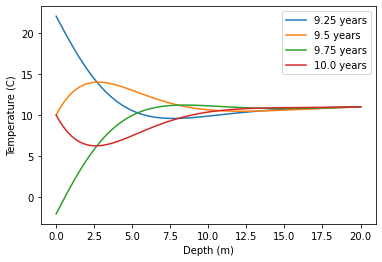

In [ ]:
# 9.4

from numpy import empty, linspace, pi,sin
from matplotlib.pyplot import plot,show,xlabel,ylabel,legend

# Constants
L = 20.0 # Length of the system
N = 100 # number of spatial points
a = L/N # point separation
h = 0.01 # time spacing in days
D = 0.1 # thermal diffusivity

# Constants for T0
A = 10.0
B = 12.0
tau = 365
Tfixed = 11.0

tmax = 10.01*365
steps = int(tmax/h)

# when to plot
s1 = int(9.25*365/h)
s2 = int(9.5*365/h)
s3 = int(9.75*365/h)
s4 = int(10.0*365/h)

# Initial conditions
T = empty(N+1,float)
T[0:N] = A
T[N] = Tfixed

# Main loop
x = linspace(0.0,L,N+1)
for k in range(steps):
  t = k*h
  T[0] = A + B*sin(2*pi*t/tau)
  T[1:N] += h*D*(T[0:N-1] + T[2:N+1] - 2*T[1:N])/(a*a)
  if (k == s1 or k == s2 or k == s3 or k == s4):
    plot(x,T,label=str(k*h/365)+" years")

xlabel("Depth (m)")
ylabel("Temperature (C)")
legend()
show()


Animation size has reached 31475096 bytes, exceeding the limit of 31457280.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


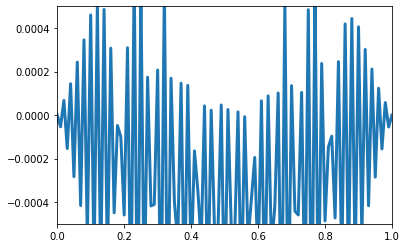

In [10]:
# 9.5
from numpy import empty, linspace, exp, zeros
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from matplotlib import animation, rc, rcParams
from IPython.display import HTML

rcParams['animation.embed_limit'] = 30

#constants
L = 1.0
d = 0.1
v = 100.0
C = 1.0
N = 100
a = L/N
sigma = 0.3

h = 7e-6

# create the initial array of y and z values
x = linspace(0.0,L,N+1)
global psi,dpsi
psi = zeros(N+1,float)
dpsi = C*x*(L-x)*exp(-(x-d)**2 / (2*sigma*sigma))/(L*L)

def f(y):
  res = empty(N+1,float)
  res[1:N] = (y[0:N-1] + y[2:N+1] - 2*y[1:N]) * (v*v)/(a*a)
  res[0] = res[N] = 0.0
  return res

def init():
  line.set_data([], [])
  return line,

def animate(i):
  global psi,dpsi
  line.set_data(x,psi)
  psi,dpsi = psi+h*dpsi,dpsi+h*f(psi)
  return line,


fig = plt.figure()
ax = plt.axes(xlim=(0, L), ylim=(-0.0005,0.0005))
line, = ax.plot([], [], lw=3)

ani = animation.FuncAnimation(fig, animate, interval=1, frames = 2100, init_func=init, blit=True)

# Note: below is the part which makes it work on Colab
rc('animation', html='jshtml')
ani

